In [1]:
import mdtraj as md
import numpy as np
import nglview as ngl
import matplotlib.pyplot as plt
from scipy import stats
import sys
blocking_dir='/storage1/thomasen/software/BLOCKING/MonoCV'
sys.path.append(blocking_dir)
import block as block
from scipy.optimize import curve_fit

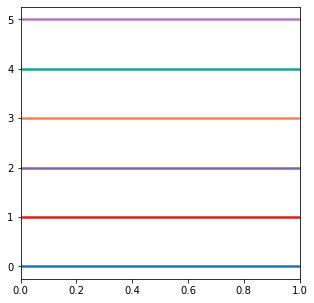

In [2]:
from matplotlib.colors import ListedColormap, LinearSegmentedColormap

new_cmap = [ '#1F78B4', '#E31A1C', '#8660AF', '#FF7F50', '#17A589', '#AF7AC5']
rtg_r = LinearSegmentedColormap.from_list("rtg", new_cmap)
colors = rtg_r(np.linspace(0,1,6))

#Test colormap
fig = plt.figure(figsize=(5,5))

for i,color in enumerate(colors):
    plt.axhline(i, color=colors[i], linewidth=2.5)

In [3]:
AAcode_dict = {'CYS': 'C', 'ASP': 'D', 'SER': 'S', 'GLN': 'Q', 'LYS': 'K',
     'ILE': 'I', 'PRO': 'P', 'THR': 'T', 'PHE': 'F', 'ASN': 'N', 
     'GLY': 'G', 'HIS': 'H', 'LEU': 'L', 'ARG': 'R', 'TRP': 'W', 
     'ALA': 'A', 'VAL':'V', 'GLU': 'E', 'TYR': 'Y', 'MET': 'M'}

In [4]:
proteins = ['SETD2_IDR1', 'SETD2_IDR2', 'SCAF1_IDR1', 'SRC3_IDR1', 'Gli3_IDR1', 'Gli3_IDR2', 'Gli2_IDR2']
errmethod = 'hline'

#Each position in list is a position in motif. AAs in str is residues allowed in that position
motif1 = ['GAVLIMWFPC', 'STCYNQDEHR', 'ST', 'STCYNQDEHR', 'ST']
motif2 = ['GAVLIMWFPC', 'STCYNQDEHR', 'ST', 'ST', 'STCYNQDEHR']

In [5]:
def block_err_analysis(CV, errmethod):
    ##Block error anaylsis
    
    #Trim Rg array for block error analysis
    CV = block.check(CV, multi=1)

    #Block error analysis
    blocks_stat = block.blocking(CV)

    #Choose optimal block size and find error
    if errmethod=='b3':
        corr_len, err = block.optimal_block(len(CV),blocks_stat,method="b3")
    elif errmethod=='knee_loc':
        corr_len, err = block.optimal_block(len(CV),blocks_stat,method="knee_loc",S=2.7)
    elif errmethod=='hline':
        corr_len, err = block.optimal_block(len(CV),blocks_stat,method="hline")
        
    return corr_len, err, blocks_stat

# Distance between neighbouring motifs only

<mdtraj.Trajectory with 1010 frames, 1445 atoms, 1445 residues, and unitcells>
MKQLQPQPPPKMGDFYDPEHPTPEEEENEAKIENVQKTGFIKGPMFKGVASSRFLPKGTKTKVNLEEQGRQKVSFSFSLTKKTLQNRFLTALGNEKQSDTPNPPAVPLQVDSTPKMKMEIGDTLSTAEESSPPKSRVELGKIHFKKHLLHVTSRPLLATTTAVASPPTHAAPLPAVIAESTTVDSPPSSPPPPPPPAQATTLSSPAPVTEPVALPHTPITVLMAAPVPLPVDVAVRSLKEPPIIIVPESLEADTKQDTISNSLEEHVTQILNEQADISSKKEDSHIGKDEEIPDSSKISLSCKKTGSKKKSSQSEGIFLGSESDEDSVRTSSSQRSHDLKFSASIEKERDFKKSSAPLKSEDLGKPSRSKTDRDDKYFSYSKLERDTRYVSSRCRSERERRRSRSHSRSERGSRTNLSYSRSERSHYYDSDRRYHRSSPYRERTRYSRPYTDNRARESSDSEEEYKKTYSRRTSSHSSSYRDLRTSSYSKSDRDCKTETSYLEMERRGKYSSKLERESKRTSENEAIKRCCSPPNELGFRRGSSYSKHDSSASRYKSTLSKPIPKSDKFKNSFCCTELNEEIKQSHSFSLQTPCSKGSELRMINKNPEREKAGSPAPSNRLNDSPTLKKLDELPIFKSEFITHDSHDSIKELDSLSKVKNDQLRSFCPIELNINGSPGAESDLATFCTSKTDAVLMTSDDSVTGSELSPLVKACMLSSNGFQNISRCKEKDLDDTCMLHKKSESPFRETEPLVSPHQDKLMSMPVMTVDYSKTVVKEPVDTRVSCCKTKDSDIYCTLNDSNPSLCNSEAENIEPSVMKISSNSFMNVHLESKPVICDSRNLTDHSKFACEEYKQSIGSTSSASVNHFDDLYQPIGSSGIASSLQSLPPGIKVDSLTLLKCGENTSPVLDAVLKSKKSSEFL

/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Number of distance points for SETD2_IDR1: 1010
Removing 1 at the bottom of each replica
Possible blocks transformations: 2

Removing 2 at the bottom of each replica
Possible blocks transformations: 30



/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Number of distance points for SETD2_IDR1: 1010
Removing 1 at the bottom of each replica
Possible blocks transformations: 2

Removing 2 at the bottom of each replica
Possible blocks transformations: 30



/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Number of distance points for SETD2_IDR1: 1010
Removing 1 at the bottom of each replica
Possible blocks transformations: 2

Removing 2 at the bottom of each replica
Possible blocks transformations: 30



/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Number of distance points for SETD2_IDR1: 1010
Removing 1 at the bottom of each replica
Possible blocks transformations: 2

Removing 2 at the bottom of each replica
Possible blocks transformations: 30



/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Number of distance points for SETD2_IDR1: 1010
Removing 1 at the bottom of each replica
Possible blocks transformations: 2

Removing 2 at the bottom of each replica
Possible blocks transformations: 30



/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Number of distance points for SETD2_IDR1: 1010
Removing 1 at the bottom of each replica
Possible blocks transformations: 2

Removing 2 at the bottom of each replica
Possible blocks transformations: 30



/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )
/lindorffgrp-isilon/thomasen/software/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Number of distance points for SETD2_IDR1: 1010
Removing 1 at the bottom of each replica
Possible blocks transformations: 2

Removing 2 at the bottom of each replica
Possible blocks transformations: 30



/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Number of distance points for SETD2_IDR1: 1010
Removing 1 at the bottom of each replica
Possible blocks transformations: 2

Removing 2 at the bottom of each replica
Possible blocks transformations: 30



/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Number of distance points for SETD2_IDR1: 1010
Removing 1 at the bottom of each replica
Possible blocks transformations: 2

Removing 2 at the bottom of each replica
Possible blocks transformations: 30



/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Number of distance points for SETD2_IDR1: 1010
Removing 1 at the bottom of each replica
Possible blocks transformations: 2

Removing 2 at the bottom of each replica
Possible blocks transformations: 30



/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Number of distance points for SETD2_IDR1: 1010
Removing 1 at the bottom of each replica
Possible blocks transformations: 2

Removing 2 at the bottom of each replica
Possible blocks transformations: 30



/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Number of distance points for SETD2_IDR1: 1010
Removing 1 at the bottom of each replica
Possible blocks transformations: 2

Removing 2 at the bottom of each replica
Possible blocks transformations: 30



/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Number of distance points for SETD2_IDR1: 1010
Removing 1 at the bottom of each replica
Possible blocks transformations: 2

Removing 2 at the bottom of each replica
Possible blocks transformations: 30



/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Number of distance points for SETD2_IDR1: 1010
Removing 1 at the bottom of each replica
Possible blocks transformations: 2

Removing 2 at the bottom of each replica
Possible blocks transformations: 30



/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Number of distance points for SETD2_IDR1: 1010
Removing 1 at the bottom of each replica
Possible blocks transformations: 2

Removing 2 at the bottom of each replica
Possible blocks transformations: 30



/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Number of distance points for SETD2_IDR1: 1010
Removing 1 at the bottom of each replica
Possible blocks transformations: 2

Removing 2 at the bottom of each replica
Possible blocks transformations: 30



/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


<mdtraj.Trajectory with 1010 frames, 440 atoms, 440 residues, and unitcells>
VYRIPKKSQTEKENTTTERGRDAVGFRDQTPAPKTPNRSRERDPDKQTQNKEKRKRRSSLSPPSSAYERGTKRPDDRYDTPTSKKKVRIKDRNKLSTEERRKLFEQEVAQREAQKQQQQMQNLGMTSPLPYDSLGYNAPHHPFAGYPPGYPMQAYVDPSNPNAGKVLLPTPSMDPVCSPAPYDHAQPLVGHSTEPLSAPPPVPVVPHVAAPVEVSSSQYVAQSDGVVHQDSSVAVLPVPAPGPVQGQNYSVWDSNQQSVSVQQQYSPAQSQATIYYQGQTCPTVYGVTSPYSQTTPPIVQSYAQPSLQYIQGQQIFTAHPQGVVVQPAAAVTTIVAPGQPQPLQPSEMVVTNNLLDLPPPSPPKPKTIVLPPNWKTARDPEGKIYYYHVITRQTQWDPPTWESPGDDASLEHEAEMDLGTPTYDENPMKASKKPKTAEAD
[189, 213, 289]
[191 215 291]
Number of distance points for SETD2_IDR2: 1010
Removing 1 at the bottom of each replica
Possible blocks transformations: 2

Removing 2 at the bottom of each replica
Possible blocks transformations: 30



/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Number of distance points for SETD2_IDR2: 1010
Removing 1 at the bottom of each replica
Possible blocks transformations: 2

Removing 2 at the bottom of each replica
Possible blocks transformations: 30



/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


<mdtraj.Trajectory with 1010 frames, 1201 atoms, 1201 residues, and unitcells>
MEEEDESRGKTEESGEDRGDGPPDRDPTLSPSAFILRAIQQAVGSSLQGDLPNDKDGSRCHGLRWRRCRSPRSEPRSQESGGTDTATVLDMATDSFLAGLVSVLDPPDTWVPSRLDLRPGESEDMLELVAEVRIGDRDPIPLPVPSLLPRLRAWRTGKTVSPQSNSSRPTCARHLTLGTGDGGPAPPPAPSSASSSPSPSPSSSSPSPPPPPPPPAPPAPPAPRFDIYDPFHPTDEAYSPPPAPEQKYDPFEPTGSNPSSSAGTPSPEEEEEEEEEEEEEEEDEEEEEGLSQSISRISETLAGIYDDNSLSQDFPGDESPRPDAQPTQPTPAPGTPPQVDSTRADGAMRRRVFVVGTEAEACREGKVSVEVVTAGGAALPPPLLPPGDSEIEEGEIVQPEEEPRLALSLFRPGGRAARPTPAASATPTAQPLPQPPAPRAPEGDDFLSLHAESDGEGALQVDLGEPAPAPPAADSRWGGLDLRRKILTQRRERYRQRSPSPAPAPAPAAAAGPPTRKKSRRERKRSGEAKEAASSSSGTQPAPPAPASPWDSKKHRSRDRKPGSHASSSARRRSRSRSRSRSTRRRSRSTDRRRGGSRRSRSREKRRRRRRSASPPPATSSSSSSRRERHRGKHRDGGGSKKKKKRSRSRGEKRSGDGSEKAPAPAPPPSGSTSCGDRDSRRRGAVPPSIQDLTDHDLFAIKRTITVGRLDKSDPRGPSPAPASSPKREVLYDSEGLSGEERGGKSSQKDRRRSGAASSSSSSREKGSRRKALDGGDRDRDRDRDRDRDRSSKKARPPKESAPSSGPPPKPPVSSGSGSSSSSSSCSSRKVKLQSKVAVLIREGVSSTTPAKDAASAGLGSIGVKFSRDRESRSPFLKPDERAPTEMAKAAPGSTKPKKTKVKAKAGAKKTKGTKGKTKPS

/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Number of distance points for SCAF1_IDR1: 1010
Removing 1 at the bottom of each replica
Possible blocks transformations: 2

Removing 2 at the bottom of each replica
Possible blocks transformations: 30



/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Number of distance points for SCAF1_IDR1: 1010
Removing 1 at the bottom of each replica
Possible blocks transformations: 2

Removing 2 at the bottom of each replica
Possible blocks transformations: 30



/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Number of distance points for SCAF1_IDR1: 1010
Removing 1 at the bottom of each replica
Possible blocks transformations: 2

Removing 2 at the bottom of each replica
Possible blocks transformations: 30



/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Number of distance points for SCAF1_IDR1: 1010
Removing 1 at the bottom of each replica
Possible blocks transformations: 2

Removing 2 at the bottom of each replica
Possible blocks transformations: 30



/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Number of distance points for SCAF1_IDR1: 1010
Removing 1 at the bottom of each replica
Possible blocks transformations: 2

Removing 2 at the bottom of each replica
Possible blocks transformations: 30



/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Number of distance points for SCAF1_IDR1: 1010
Removing 1 at the bottom of each replica
Possible blocks transformations: 2

Removing 2 at the bottom of each replica
Possible blocks transformations: 30



/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Number of distance points for SCAF1_IDR1: 1010
Removing 1 at the bottom of each replica
Possible blocks transformations: 2

Removing 2 at the bottom of each replica
Possible blocks transformations: 30



/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Number of distance points for SCAF1_IDR1: 1010
Removing 1 at the bottom of each replica
Possible blocks transformations: 2

Removing 2 at the bottom of each replica
Possible blocks transformations: 30



/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Number of distance points for SCAF1_IDR1: 1010
Removing 1 at the bottom of each replica
Possible blocks transformations: 2

Removing 2 at the bottom of each replica
Possible blocks transformations: 30



/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Number of distance points for SCAF1_IDR1: 1010
Removing 1 at the bottom of each replica
Possible blocks transformations: 2

Removing 2 at the bottom of each replica
Possible blocks transformations: 30



/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Number of distance points for SCAF1_IDR1: 1010
Removing 1 at the bottom of each replica
Possible blocks transformations: 2

Removing 2 at the bottom of each replica
Possible blocks transformations: 30



/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


<mdtraj.Trajectory with 1010 frames, 1052 atoms, 1052 residues, and unitcells>
EQNGYRPNPNPVGQGIRPPMAGCNSSVGGMSMSPNQGLQMPSSRAYGLADPSTTGQMSGARYGGSSNIASLTPGPGMQSPSSYQNNNYGLNMSSPPHGSPGLAPNQQNIMISPRNRGSPKIASHQFSPVAGVHSPMASSGNTGNHSFSSSSLSALQAISEGVGTSLLSTLSSPGPKLDNSPNMNITQPSKVSNQDSKSPLGFYCDQNPVESSMCQSNSRDHLSDKESKESSVEGAENQRGPLESKGHKKLLQLLTCSSDDRGHSSLTNSPLDSSCKESSVSVTSPSGVSSSTSGGVSSTSNMHGSLLQEKHRILHKLLQNGNSPAEVAKITAEATGKDTSSITSCGDGNVVKQEQLSPKKKENNALLRYLLDRDDPSDALSKELQPQVEGVDNKMSQCTSSTIPSSSQEKDPKIKTETSEEGSGDLDNLDAILGDLTSSDFYNNSISSNGSHLGTKQQVFQGTNSLGLKSSQSVQSIRPPYNRAVSLDSPVSVGSSPPVKNISAFPMLPKQPMLGGNPRMMDSQENYGSSMGGPNRNVTVTQTPSSGDWGLPNSKAGRMEPMNSNSMGRPGGDYNTSLPRPALGGSIPTLPLRSNSIPGARPVLQQQQQMLQMRPGEIPMGMGANPYGQAAASNQLGSWPDGMLSMEQVSHGTQNRPLLRNSLDDLVGPPSNLEGQSDERALLDQLHTLLSNTDATGLEEIDRALGIPELVNQGQALEPKQDAFQGQEAAVMMDQKAGLYGQTYPAQGPPMQGGFHLQGQSPSFNSMMNQMNQQGNFPLQGMHPRANIMRPRTNTPKQLRMQLQQRLQGQQFLNQSRQALELKMENPTAGGAAVMRPMMQPQVSSQQGFLNAQMVAQRSRELLSHHFRQQRVAMMMQQQQQQQQQQQQQQQQQQQQQQQQQQQQQTQAFSPPPNVTASPSM

/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Number of distance points for SRC3_IDR1: 1010
Removing 1 at the bottom of each replica
Possible blocks transformations: 2

Removing 2 at the bottom of each replica
Possible blocks transformations: 30



/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Number of distance points for SRC3_IDR1: 1010
Removing 1 at the bottom of each replica
Possible blocks transformations: 2

Removing 2 at the bottom of each replica
Possible blocks transformations: 30



/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Number of distance points for SRC3_IDR1: 1010
Removing 1 at the bottom of each replica
Possible blocks transformations: 2

Removing 2 at the bottom of each replica
Possible blocks transformations: 30



/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Number of distance points for SRC3_IDR1: 1010
Removing 1 at the bottom of each replica
Possible blocks transformations: 2

Removing 2 at the bottom of each replica
Possible blocks transformations: 30



/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Number of distance points for SRC3_IDR1: 1010
Removing 1 at the bottom of each replica
Possible blocks transformations: 2

Removing 2 at the bottom of each replica
Possible blocks transformations: 30



/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Number of distance points for SRC3_IDR1: 1010
Removing 1 at the bottom of each replica
Possible blocks transformations: 2

Removing 2 at the bottom of each replica
Possible blocks transformations: 30



/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Number of distance points for SRC3_IDR1: 1010
Removing 1 at the bottom of each replica
Possible blocks transformations: 2

Removing 2 at the bottom of each replica
Possible blocks transformations: 30



/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Number of distance points for SRC3_IDR1: 1010
Removing 1 at the bottom of each replica
Possible blocks transformations: 2

Removing 2 at the bottom of each replica
Possible blocks transformations: 30



/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Number of distance points for SRC3_IDR1: 1010
Removing 1 at the bottom of each replica
Possible blocks transformations: 2

Removing 2 at the bottom of each replica
Possible blocks transformations: 30



/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


<mdtraj.Trajectory with 1010 frames, 477 atoms, 477 residues, and unitcells>
MEAQSHSSTTTEKKKVENSIVKCSTRTDVSEKAVASSTTSNEDESPGQTYHRERRNAITMQPQNVQGLSKVSEEPSTSSDERASLIKKEIHGSLPHVAEPSVPYRGTVFAMDPRNGYMEPHYHPPHLFPAFHPPVPIDARHHEGRYHYDPSPIPPLHMTSALSSSPTYPDLPFIRISPHRNPTAASESPFSPPHPYINPYMDYIRSLHSSPSLSMISATRGLSPTDAPHAGVSPAEYYHQMALLTGQRSPYADIIPSAATAGTGAIHMEYLHAMDSTRFSSPRLSARPSRKRTLSISPLSDHSFDLQTMIRTSPNSLVTILNNSRSSSSASGSYGHLSASAISPALSFTYSSAPVSLHMHQQILSRQQSLGSAFGHSPPLIHPAPTFPTQRPIPGIPTVLNPVQVSSGPSESSQNKPTSESAVSSTGDPMHNKRSKIKPDEDLPSPGARGQQEQPEGTTLVKEEGDKDESKQEPEVI
[2, 22, 34, 74, 273, 416]
[  4  24  36  76 275 418]
Number of distance points for Gli3_IDR1: 1010
Removing 1 at the bottom of each replica
Possible blocks transformations: 2

Removing 2 at the bottom of each replica
Possible blocks transformations: 30



/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Number of distance points for Gli3_IDR1: 1010
Removing 1 at the bottom of each replica
Possible blocks transformations: 2

Removing 2 at the bottom of each replica
Possible blocks transformations: 30



/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Number of distance points for Gli3_IDR1: 1010
Removing 1 at the bottom of each replica
Possible blocks transformations: 2

Removing 2 at the bottom of each replica
Possible blocks transformations: 30



/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Number of distance points for Gli3_IDR1: 1010
Removing 1 at the bottom of each replica
Possible blocks transformations: 2

Removing 2 at the bottom of each replica
Possible blocks transformations: 30



/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Number of distance points for Gli3_IDR1: 1010
Removing 1 at the bottom of each replica
Possible blocks transformations: 2

Removing 2 at the bottom of each replica
Possible blocks transformations: 30



/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


<mdtraj.Trajectory with 1010 frames, 946 atoms, 946 residues, and unitcells>
PEAHVTKKQRGDIHPRPPPPRDSGSHSQSRSPGRPTQGALGEQQDLSNTTSKREECLQVKTVKAEKPMTSQPSPGGQSSCSSQQSPISNYSNSGLELPLTDGGSIGDLSAIDETPIMDSTISTATTALALQARRNPAGTKWMEHVKLERLKQVNGMFPRLNPILPPKAPAVSPLIGNGTQSNNTCSLGGPMTLLPGRSDLSGVDVTMLNMLNRRDSSASTISSAYLSSRRSSGISPCFSSRRSSEASQAEGRPQNVSVADSYDPISTDASRRSSEASQSDGLPSLLSLTPAQQYRLKAKYAAATGGPPPTPLPNMERMSLKTRLALLGDALEPGVALPPVHAPRRCSDGGAHGYGRRHLQPHDAPGHGVRRASDPVRTGSEGLALPRVPRFSSLSSCNPPAMATSAEKRSLVLQNYTRPEGGQSRNFHSSPCPPSITENVTLESLTMDADANLNDEDFLPDDVVQYLNSQNQAGYEQHFPSALPDDSKVPHGPGDFDAPGLPDSHAGQQFHALEQPCPEGSKTDLPIQWNEVSSGSADLSSSKLKCGPRPAVPQTRAFGFCNGMVVHPQNPLRSGPAGGYQTLGENSNPYGGPEHLMLHNSPGSGTSGNAFHEQPCKAPQYGNCLNRQPVAPGALDGACGAGIQASKLKSTPMQGSGGQLNFGLPVAPNESAGSMVNGMQNQDPVGQGYLAHQLLGDSMQHPGAGRPGQQMLGQISATSHINIYQGPESCLPGAHGMGSQPSSLAVVRGYQPCASFGGSRRQAMPRDSLALQSGQLSDTSQTCRVNGIKMEMKGQPHPLCSNLQNYSGQFYDQTVGFSQQDTKAGSFSISDASCLLQGTSAKNSELLSPGANQVTSTVDSLDSHDLEGVQIDFDAIIDDGDHSSLMSGALSPSIIQNLSHSSSRLTTPRASLPFPALSMSTTN

/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


<mdtraj.Trajectory with 1010 frames, 995 atoms, 995 residues, and unitcells>
PDAHVTKKQRNDVHLRTPLLKENGDSEAGTEPGGPESTEASSTSQAVEDCLHVRAIKTESSGLCQSSPGAQSSCSSEPSPLGSAPNNDSGVEMPGTGPGSLGDLTALDDTPPGADTSALAAPSAGGLQLRKHMTTMHRFEQLKKEKLKSLKDSCSWAGPTPHTRNTKLPPLPGSGSILENFSGSGGGGPAGLLPNPRLSELSASEVTMLSQLQERRDSSTSTVSSAYTVSRRSSGISPYFSSRRSSEASPLGAGRPHNASSADSYDPISTDASRRSSEASQCSGGSGLLNLTPAQQYSLRAKYAAATGGPPPTPLPGLERMSLRTRLALLDAPERTLPAGCPRPLGPRRGSDGPTYGHGHAGAAPAFPHEAPGGGARRASDPVRRPDALSLPRVQRFHSTHNVNPGPLPPCADRRGLRLQSHPSTDGGLARGAYSPRPPSISENVAMEAVAAGVDGAGPEADLGLPEDDLVLPDDVVQYIKAHASGALDEGTGQVYPTESTGFSDNPRLPSPGLHGQRRMVAADSNVGPSAPMLGGCQLGFGAPSSLNKNNMPVQWNEVSSGTVDALASQVKPPPFPQGNLAVVQQKPAFGQYPGYSPQGLQASPGGLDSTQPHLQPRSGAPSQGIPRVNYMQQLRQPVAGSQCPGMTTTMSPHACYGQVHPQLSPSTISGALNQFPQSCSNMPAKPGHLGHPQQTEVAPDPTTMGNRHRELGVPDSALAGVPPPHPVQSYPQQSHHLAASMSQEGYHQVPSLLPARQPGFMEPQTGPMGVATAGFGLVQPRPPLEPSPTGRHRGVRAVQQQLAYARATGHAMAAMPSSQETAEAVPKGAMGNMGSVPPQPPPQDAGGAPDHSMLYYYGQIHMYEQDGGLENLGSCQVMRSQPPQPQACQDSIQPQPLPSPGVNQVSSTVDSQLLEAPQIDFD

/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Number of distance points for Gli2_IDR2: 1010
Removing 1 at the bottom of each replica
Possible blocks transformations: 2

Removing 2 at the bottom of each replica
Possible blocks transformations: 30



/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Number of distance points for Gli2_IDR2: 1010
Removing 1 at the bottom of each replica
Possible blocks transformations: 2

Removing 2 at the bottom of each replica
Possible blocks transformations: 30



/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Number of distance points for Gli2_IDR2: 1010
Removing 1 at the bottom of each replica
Possible blocks transformations: 2

Removing 2 at the bottom of each replica
Possible blocks transformations: 30



/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


Number of distance points for Gli2_IDR2: 1010
Removing 1 at the bottom of each replica
Possible blocks transformations: 2

Removing 2 at the bottom of each replica
Possible blocks transformations: 30



/storage1/thomasen/software/BLOCKING/MonoCV/block.py:59: RuntimeWarning: invalid value encountered in double_scalars
  err = np.sqrt( ((blocks_av - u)**2).sum() / (Nb*(Nb-1)) )


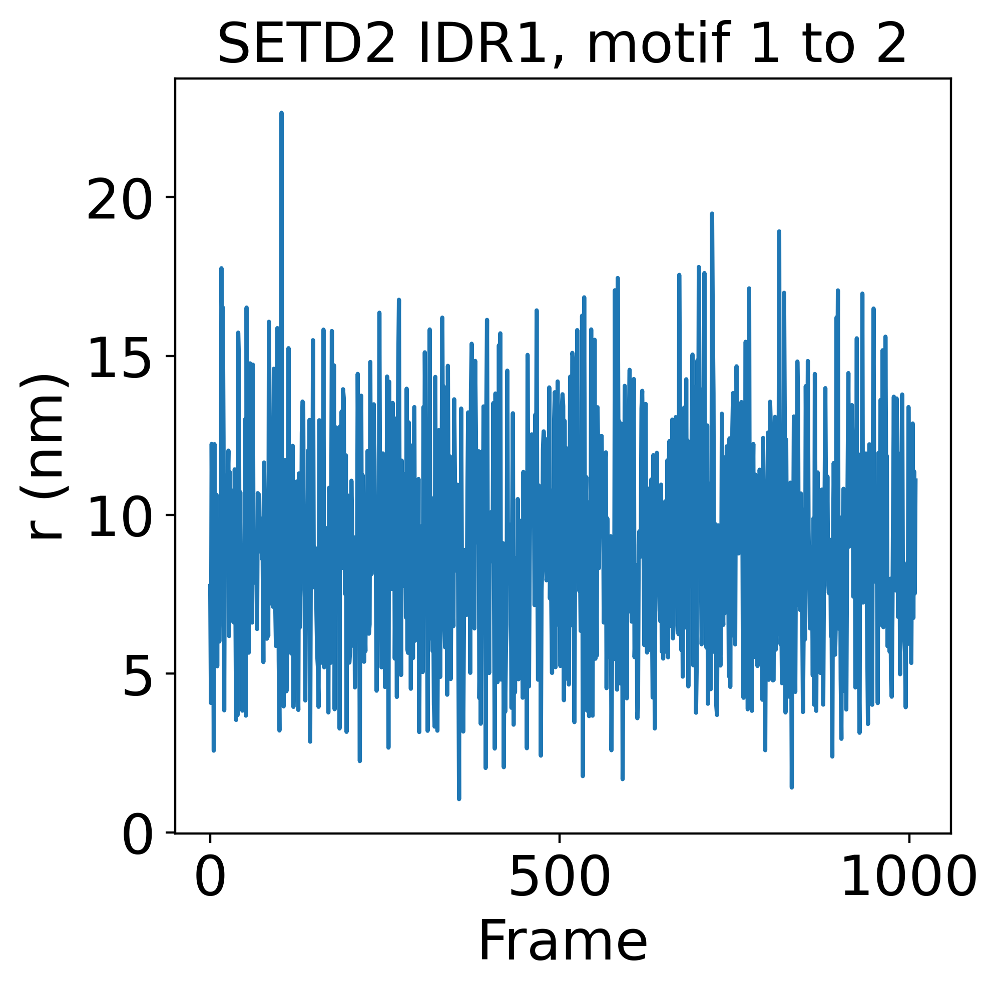

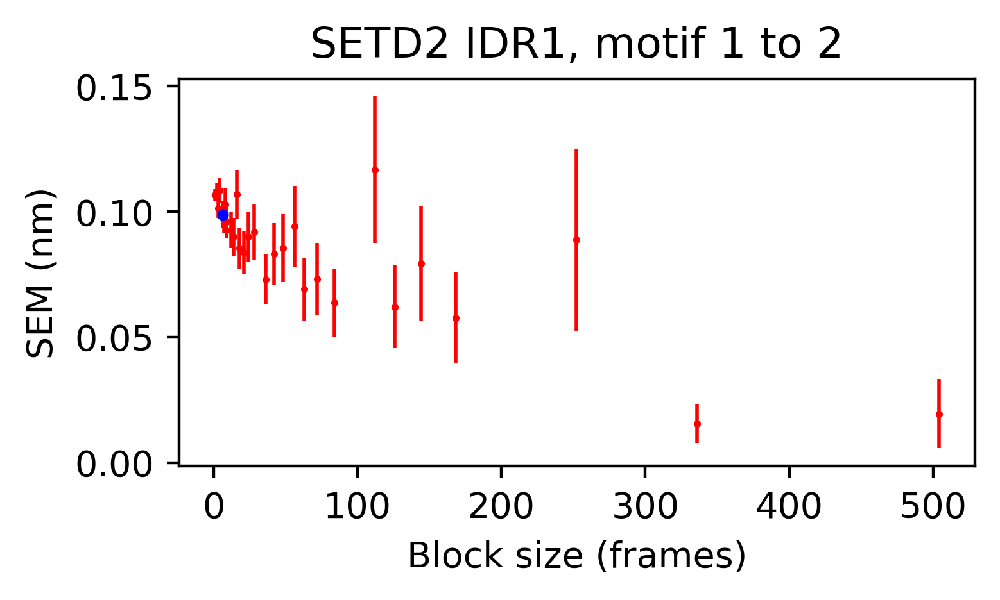

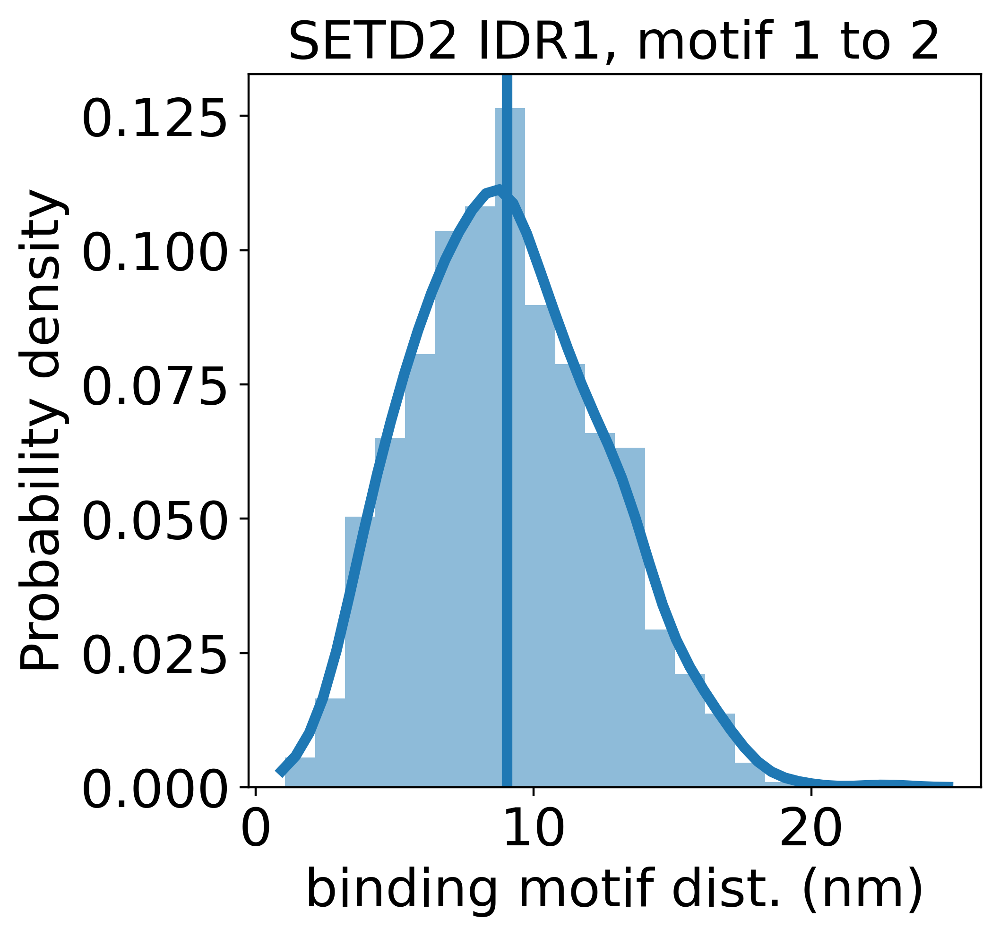

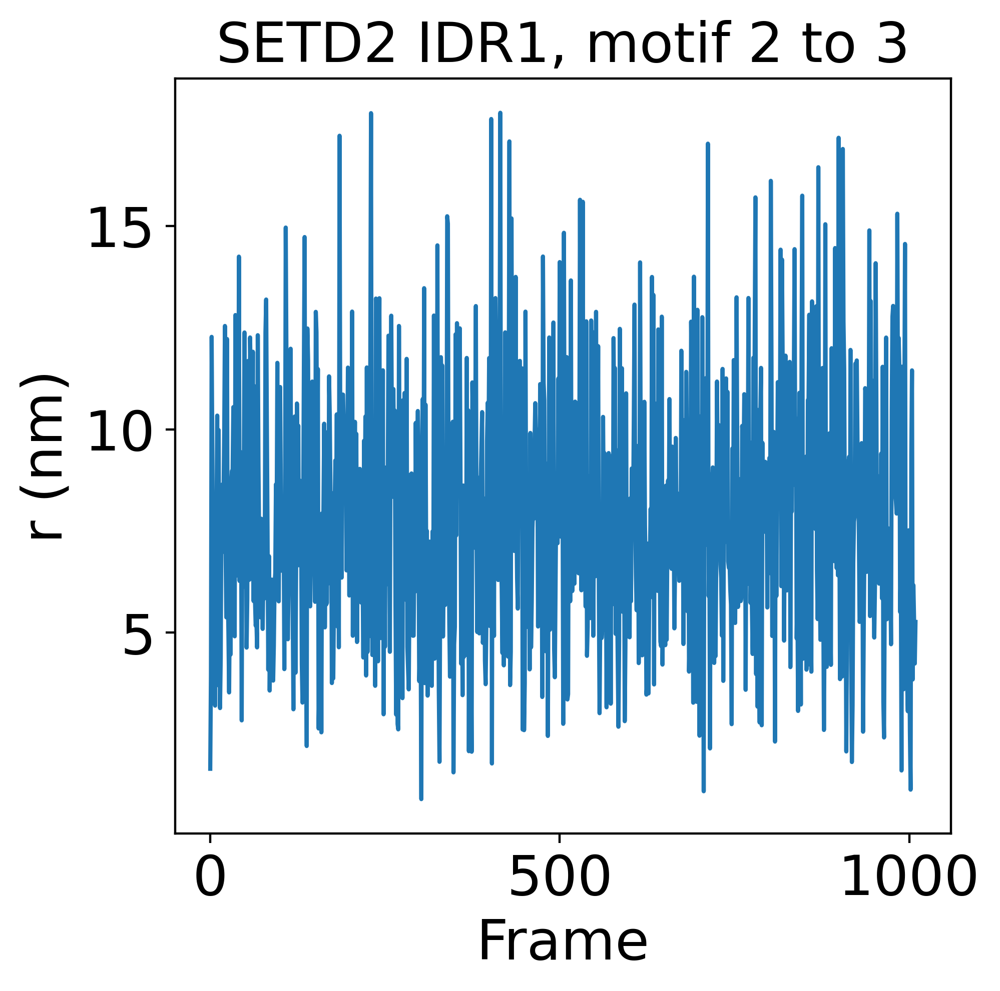

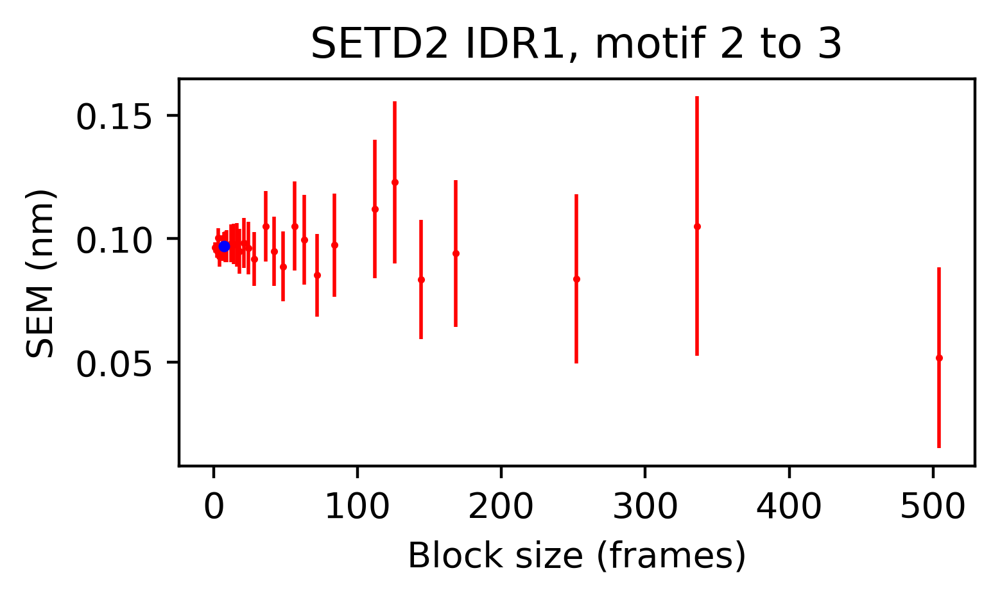

...

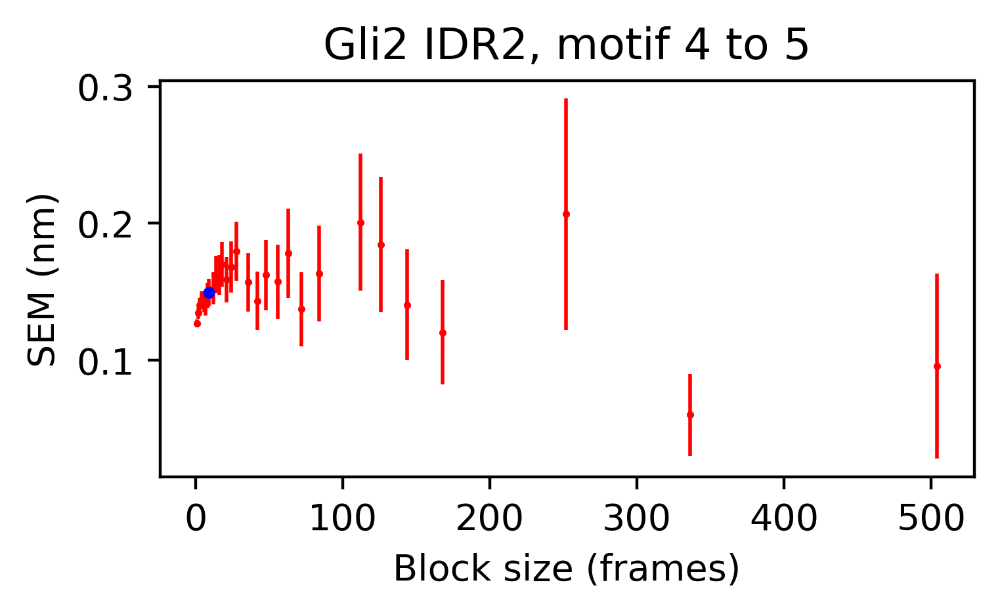

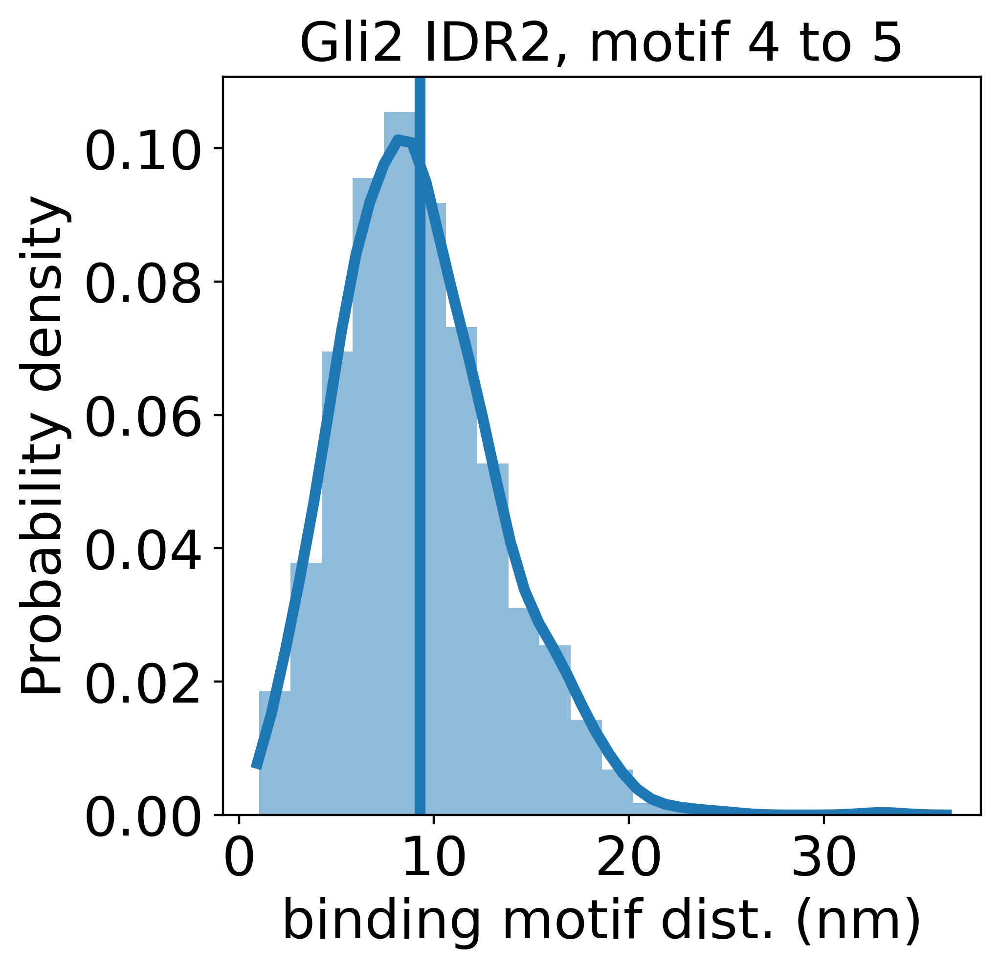

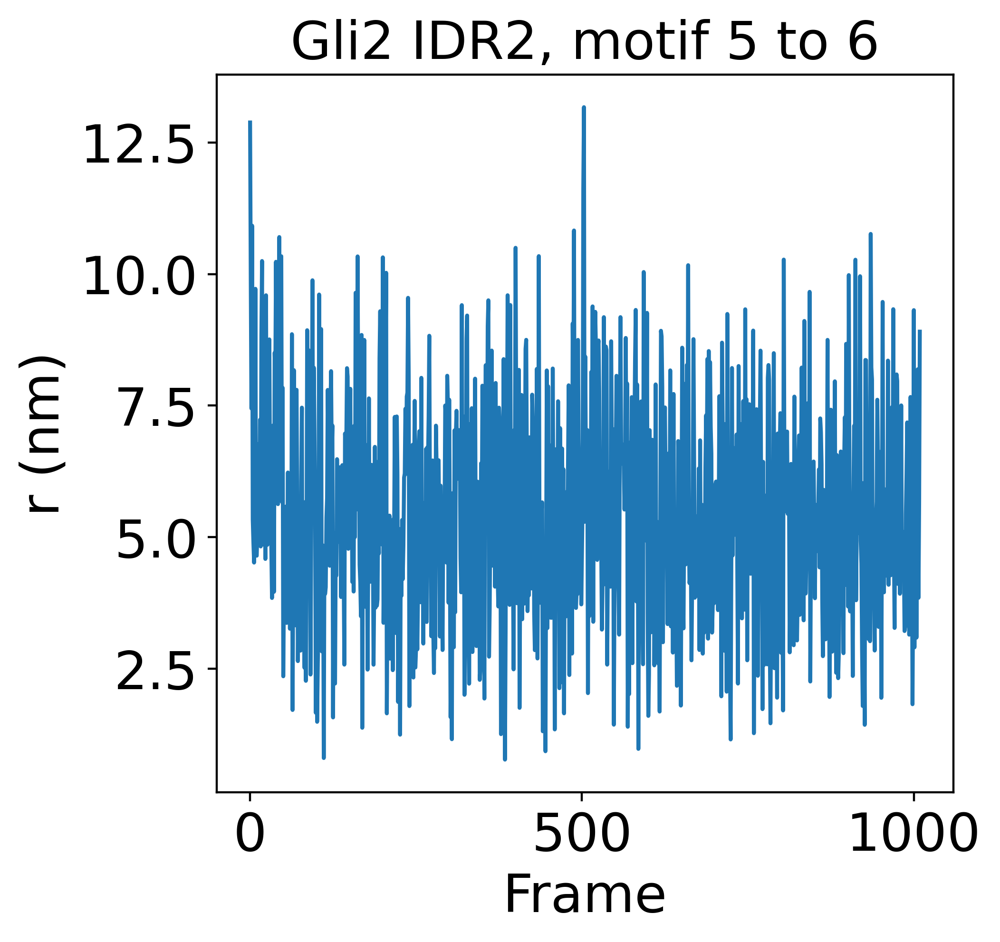

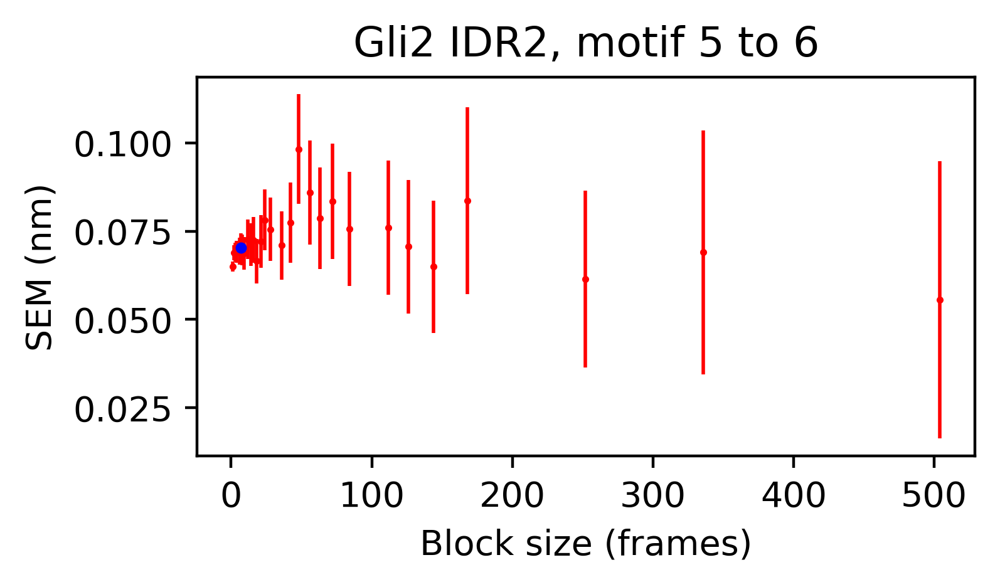

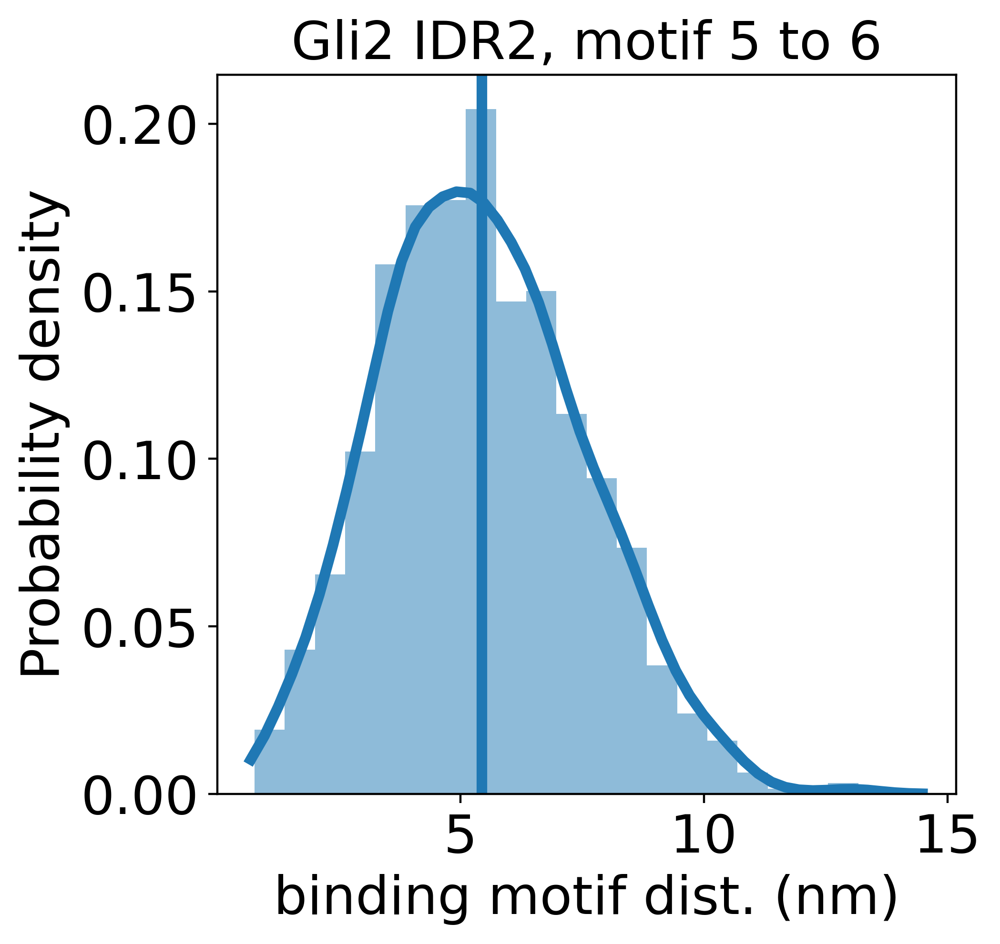

In [6]:
r_all = np.array([])

r_avg_vs_motifs_vs_protein = []
motif_seqdist_vs_motifs_vs_protein = []

for protein in proteins:
    #Load traj
    traj = md.load(f'{protein}/traj.xtc', top=f'{protein}/top.pdb')
    print(traj)
    
    #Get sequence from traj top
    seq = ''
    for residue in traj.top.residues:
        res = AAcode_dict[str(residue)[:3]]
        seq += res
    print(seq)

    #Loop over res positions in protein and get positions of motifs
    motif_startindeces = []
    for i,res in enumerate(seq[:len(seq)-4]):
        #Check for motif1 starting from current resi
        if res in motif1[0] and seq[i+1] in motif1[1] and seq[i+2] in motif1[2] and seq[i+3] in motif1[3] and seq[i+4] in motif1[4]:
            motif_startindeces.append(i)

        #Check for motif2 starting from current resi
        if res in motif2[0] and seq[i+1] in motif2[1] and seq[i+2] in motif2[2] and seq[i+3] in motif2[3] and seq[i+4] in motif2[4] and i not in motif_startindeces:
            motif_startindeces.append(i)
    print(motif_startindeces)
    
    #Get middle residue of motifs instead of 
    motif_midindeces = np.array(motif_startindeces) + 2
    print(motif_midindeces)
    
    #Make nice looking name for plotting
    protein_name = protein.replace('_', ' ')
    
    r_avg_vs_motifs = []
    motif_seqdist_vs_motifs = []
    #Loop over combinations of motifs in protein
    for i,res1 in enumerate(motif_midindeces[:len(motif_midindeces)-1]):
        
        res2 = motif_midindeces[i+1]
        
        #Calculate distance between middle res in motifs
        res_pair = [[res1, res2]]
        r = md.compute_contacts(traj, contacts=res_pair, scheme='closest-heavy')
        r = np.reshape(r[0], len(r[0])) #THIS ONLY MAKES SENSE IF ALL SIMULATIONS HAVE SAME NUMBER OF FRAMES
        
        r_avg = np.average(r)
        r_avg_vs_motifs.append(r_avg)
        motif_seqdist = res2 - res1
        motif_seqdist_vs_motifs.append(motif_seqdist)
        
        r_all = np.concatenate((r_all, r))
        print(f'Number of distance points for {protein}: {len(r)}')

        #Plot r time-series
        fig = plt.figure(figsize=(5,5), dpi=400)
        plt.title(f'{protein_name}, motif {i+1} to {i+2}', fontsize=20)
        plt.xlabel('Frame', fontsize=20)
        plt.ylabel('r (nm)', fontsize=20)
        plt.tick_params(axis='both', which='major', labelsize=20)
        plt.plot(r)

        #Block error analysis
        corr_len, err, blocks_stat = block_err_analysis(r, errmethod)
        fig = plt.figure(figsize=(4, 2), dpi=400, facecolor='w')
        plt.title(f'{protein_name}, motif {i+1} to {i+2}')
        plt.xlabel('Block size (frames)')
        plt.ylabel('SEM (nm)')
        plt.errorbar(blocks_stat[...,0],blocks_stat[...,1],blocks_stat[...,2],fmt='ro',ms=1,elinewidth=1)
        plt.scatter(corr_len,err,c='blue',zorder=300,s=5)

        #Plot histogram
        fig = plt.figure(figsize=(5,5), dpi=400)
        plt.title(f'{protein_name}, motif {i+1} to {i+2}', fontsize=20)
        plt.xlabel('binding motif dist. (nm)', fontsize=20)
        plt.ylabel('Probability density', fontsize=20)
        plt.tick_params(axis='both', which='major', labelsize=20)

        #KDE
        kde_x = np.linspace( np.amin(r)*0.9, np.amax(r)*1.1, num = 50 )
        kde_y = stats.gaussian_kde(r, bw_method = "silverman").evaluate(kde_x)

        plt.hist(r, density=True, alpha=0.5, bins=20, color=colors[0])
        plt.plot(kde_x, kde_y, '-', linewidth=4, color=colors[0])
        plt.axvline(np.average(r), linewidth=4, color=colors[0])
        
    r_avg_vs_motifs_vs_protein.append(r_avg_vs_motifs)
    motif_seqdist_vs_motifs_vs_protein.append(motif_seqdist_vs_motifs)

# Compare all with MATH spacing

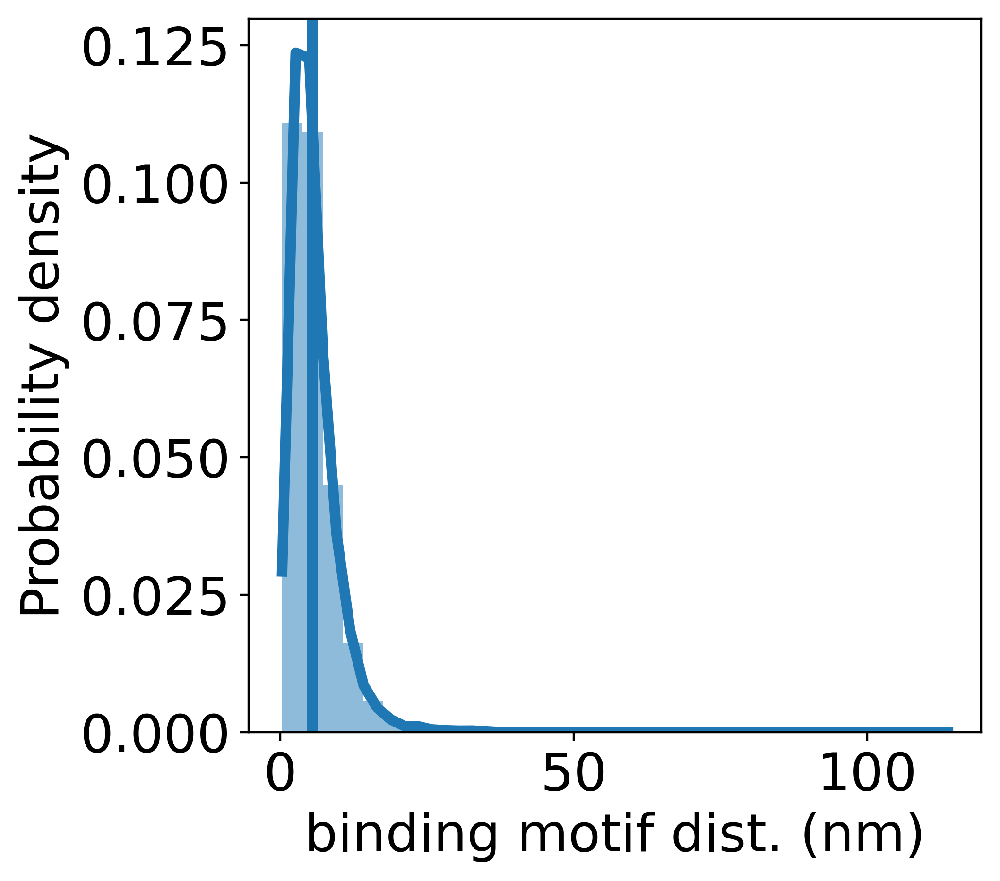

In [7]:
#Plot histogram of SPOP-binding motif-motif distances for all motifs in all proteins simulated
fig = plt.figure(figsize=(5,5), dpi=400)
plt.xlabel('binding motif dist. (nm)', fontsize=20)
plt.ylabel('Probability density', fontsize=20)
plt.tick_params(axis='both', which='major', labelsize=20)

#KDE
kde_x = np.linspace( np.amin(r_all)*0.9, np.amax(r_all)*1.1, num = 50 )
kde_y = stats.gaussian_kde(r_all, bw_method = "silverman").evaluate(kde_x)

plt.hist(r_all, density=True, alpha=0.5, bins=30, color=colors[0])
plt.plot(kde_x, kde_y, '-', linewidth=4, color=colors[0])
plt.axvline(np.average(r_all), linewidth=4, color=colors[0])

MATH_type='MATHfree'
oligomersizes = range(2, 61, 2)

#Make array of fitted weights
weights_vs_size = []
for size in oligomersizes:
    weights = np.genfromtxt(f'../Production_run/weights_averaged/weights_{size}mer.dat', usecols=(1))
    weights_vs_size.append(weights)
weights_vs_size = np.array(weights_vs_size)


#Get distances between substrate binding domains in all neighbouring MATH domains

MATH_MATHright_bindingsite_dist_all = np.array([])
weights_all = np.array([])

for i,size in enumerate(oligomersizes):
      
    MATH_MATHright_bindingsite_dist_avg_vs_subunit = []
    MATH_MATHright_bindingsite_dist_avg_rew_vs_subunit = []

    for subunit in range(1, size):
        #Load distances from gmx file
        MATH_MATHright_bindingsite_dist = np.genfromtxt(f'../Production_run/{MATH_type}_runs/SPOP_{size}mer/MATH_MATH_bindingsite_distance/comdist_MATH_{subunit}_MATHright.xvg', usecols=(1), skip_header=17, unpack=True)
        
        assert len(MATH_MATHright_bindingsite_dist) == 15001
        
        #Get all distances and weights in flat array for histogram
        MATH_MATHright_bindingsite_dist_all = np.concatenate((MATH_MATHright_bindingsite_dist_all, MATH_MATHright_bindingsite_dist))
        weights_all = np.concatenate((weights_all, weights_vs_size[i]))
        
#Renormalize flat array of weights
weights_all /= np.sum(weights_all)

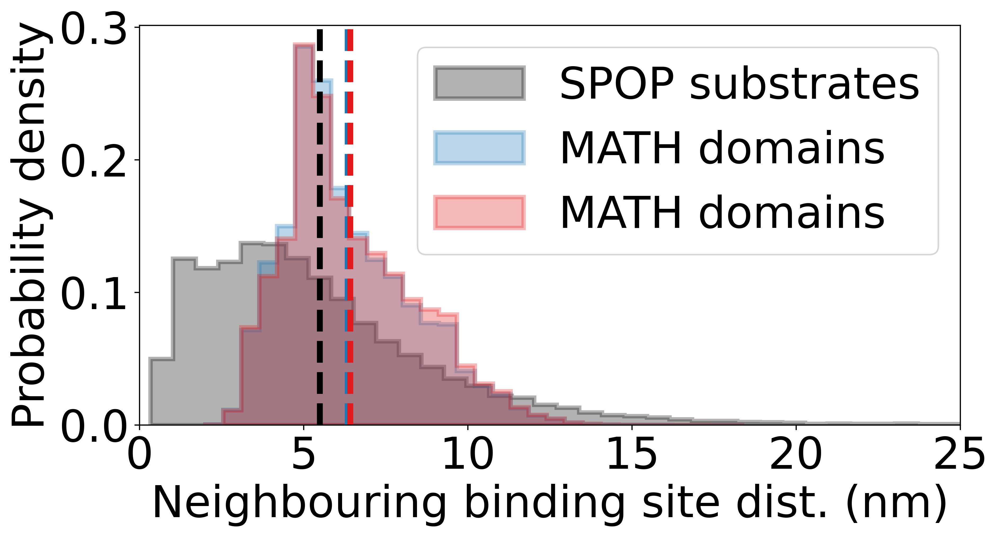

In [8]:
#Plot histogram of MATH-MATH distances and motif-motif distances together
fig = plt.figure(figsize=(10,5), dpi=400)
plt.xlabel('Neighbouring binding site dist. (nm)', fontsize=30)
plt.ylabel('Probability density', fontsize=30)
plt.tick_params(axis='both', which='major', labelsize=30)

#motif-motif distances:

#KDE
#kde_x = np.linspace( np.amin(r_all)*0.4, np.amax(r_all)*1.01, num = 50 )
#kde_y = stats.gaussian_kde(r_all, bw_method = "silverman").evaluate(kde_x)

#Plot
plt.hist(r_all, density=True, alpha=0.3, bins=150, color='black', histtype='stepfilled', edgecolor='black', linewidth=3, label='SPOP substrates')
#plt.plot(kde_x, kde_y, '-', linewidth=4, alpha=0.7, color=colors[0])
plt.axvline(np.average(r_all), linewidth=4, linestyle='--', color='black')


#MATH-MATH distances:

#KDE
#kde_x = np.linspace( np.amin(MATH_MATHright_bindingsite_dist_all)*0.9, np.amax(MATH_MATHright_bindingsite_dist_all)*1.01, num = 20 )
#kde_y = stats.gaussian_kde(MATH_MATHright_bindingsite_dist_all, bw_method = "silverman", weights=weights_all).evaluate(kde_x)

#Plot
plt.hist(MATH_MATHright_bindingsite_dist_all, density=True, alpha=0.3, bins=30, color=colors[0], histtype='stepfilled', edgecolor=colors[0], linewidth=3, label='MATH domains')
plt.hist(MATH_MATHright_bindingsite_dist_all, weights=weights_all, density=True, alpha=0.3, bins=30, color=colors[1], histtype='stepfilled', edgecolor=colors[1], linewidth=3, label='MATH domains')

#plt.plot(kde_x, kde_y, '-', linewidth=4, alpha=0.7, color=colors[1])
plt.axvline(np.average(MATH_MATHright_bindingsite_dist_all),linewidth=4, linestyle='--', color=colors[0])
plt.axvline(np.average(MATH_MATHright_bindingsite_dist_all, weights=weights_all),linewidth=4, linestyle='--', color=colors[1])

plt.xlim(0, 25)

plt.legend(fontsize=30)

fig.savefig(f"figures/neighbourdist_hist.png", bbox_inches='tight', pad_inches=1, dpi=400)
fig.savefig(f"figures/neighbourdist_hist.pdf", bbox_inches='tight', pad_inches=1, dpi=400)


# Fit power law to motif-motif spacing

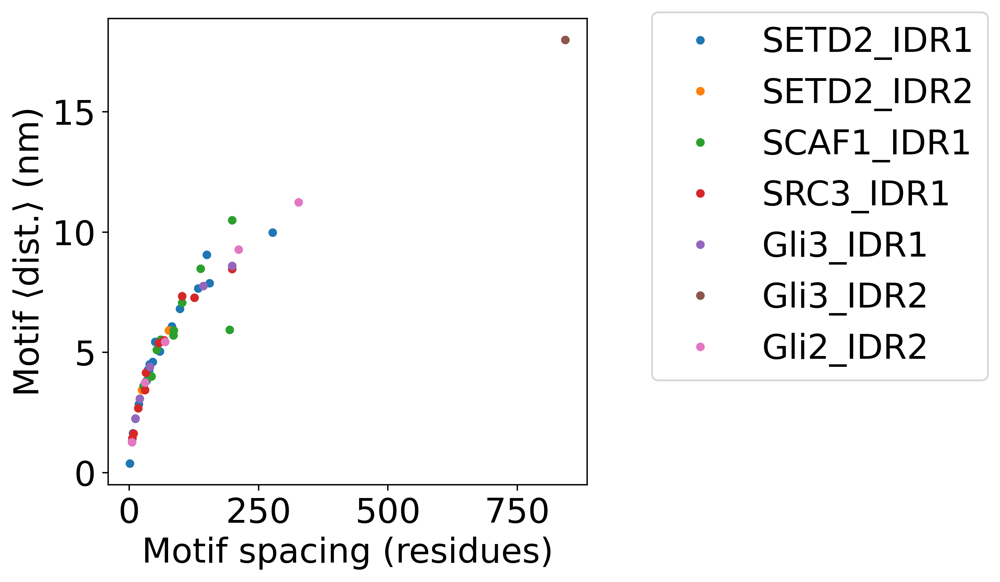

In [9]:
motif_seqdist_all = np.array([])
r_avg_all = np.array([])


fig = plt.figure(figsize=(5,5), dpi=400)
for i,protein in enumerate(proteins):
    
    r_avg_all = np.concatenate((r_avg_all, np.array(r_avg_vs_motifs_vs_protein[i])))
    motif_seqdist_all = np.concatenate((motif_seqdist_all, np.array(motif_seqdist_vs_motifs_vs_protein[i])))
                               
    #Plot
    plt.plot(motif_seqdist_vs_motifs_vs_protein[i], r_avg_vs_motifs_vs_protein[i], 'o', ms=4, alpha=1.0, label=protein)

plt.xlabel('Motif spacing (residues)', fontsize=20)
plt.ylabel('Motif ⟨dist.⟩ (nm)', fontsize=20)
plt.tick_params(axis='both', which='major', labelsize=20)
    
plt.legend(fontsize=20, bbox_to_anchor=(1.1, 1.05))


In [10]:
def dist_scaling(N, R0, v):
    return R0*(N**v)

#Fit motif dist vs motif spacing power law
popt, pcov = curve_fit(dist_scaling, motif_seqdist_all, r_avg_all)

R0_fit = popt[0]
v_fit = popt[1]

print(f'R0={R0_fit}, v={v_fit}')

R0=0.7657707351209849, v=0.4663424190163315


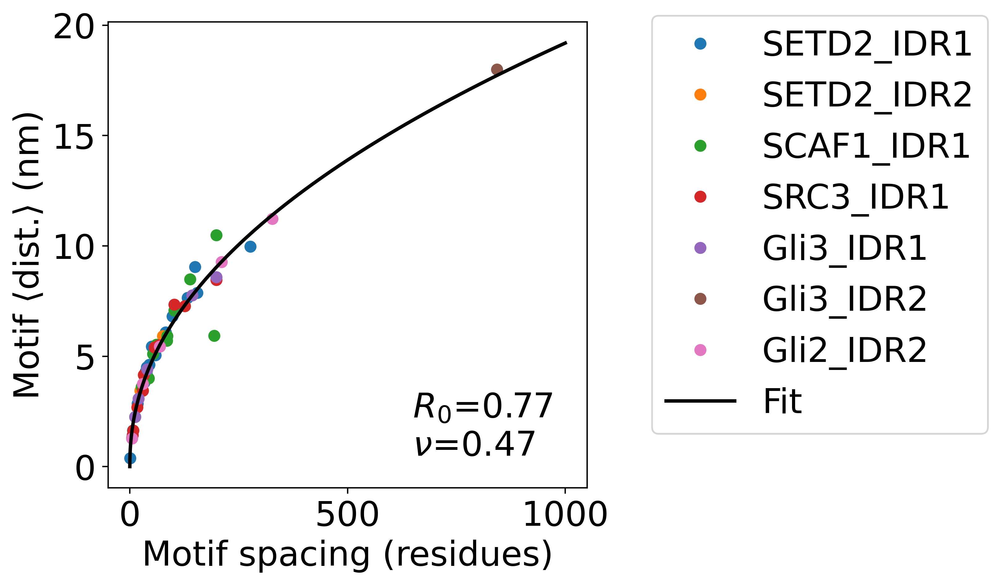

In [11]:
fig = plt.figure(figsize=(5,5), dpi=400)
for i,protein in enumerate(proteins):

    #Plot
    plt.plot(motif_seqdist_vs_motifs_vs_protein[i], r_avg_vs_motifs_vs_protein[i], 'o', ms=6, alpha=1.0, label=protein)

N_lst = np.linspace(0, 1000, 10000)
dist_scaling_fit = dist_scaling(N_lst, R0_fit, v_fit)
    
plt.plot(N_lst, dist_scaling_fit, lw=2, c='black', label='Fit')
    
plt.xlabel('Motif spacing (residues)', fontsize=20)
plt.ylabel('Motif ⟨dist.⟩ (nm)', fontsize=20)
plt.tick_params(axis='both', which='major', labelsize=20)

plt.text(650, 0.5, f'$R_0$={R0_fit:.2f}\n$ν$={v_fit:.2f}', fontsize=20)


plt.legend(fontsize=20, bbox_to_anchor=(1.1, 1.05))

fig.savefig(f"figures/motifneighbourdist_vs_motifseqdist_fit.png", bbox_inches='tight', pad_inches=1, dpi=400)
fig.savefig(f"figures/motifneighbourdist_vs_motifseqdist_fit.pdf", bbox_inches='tight', pad_inches=1, dpi=400)
